### Detecção de objetos em imagens


O Objetivo nesse notebook é fazer detecção de objetos em imagens, vamos tomar uma imagem com vários objetos e o algoritmo vai nos retornar objetos destacados na imagem

Para isso, vamos usar em conjunto duas ferramentas:

__1 - Selective Search da biblioteca OpenCV__

__2 - Rede neural VGG19 do Keras__

A ideia é usar o Selective Search para pegar vários retângulos de destaque na imagem que escolheremos, e usaremos as novas imagens geradas por cada um desses retângulos na VGG19 que nos retornará uma probabilidade de determinado objeto está em cada uma das imagens geradas.

Depois pegaremos as imagens onde tivermos uma maior probabilidade, e analisaremos os resultados.

Os objetos retornados será nossa predição final!

In [4]:
# importando as bibliotecas que precisaremos inicialmente

import matplotlib.pyplot as plt
import numpy as np
import cv2
from keras.preprocessing.image import load_img

Vamos escolher uma imagem de uma sala com vários objetos e veremos como nosso algoritmo se sai.

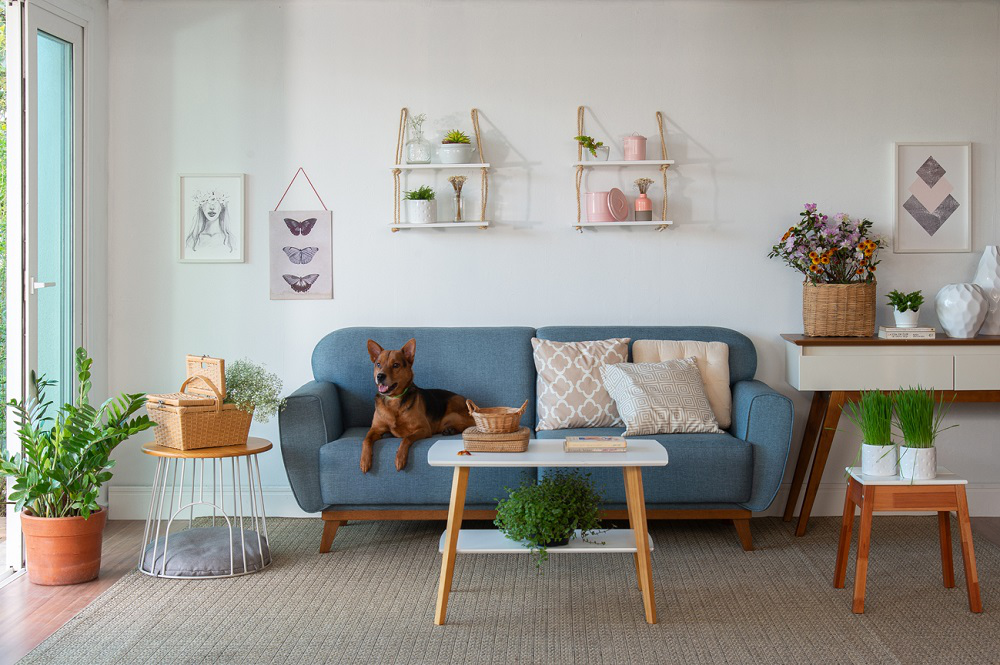

In [43]:
image0 = load_img('sala.jpg')

image0

In [47]:
# carregando a imagem com o OpenCV e normalizando

image = cv2.imread('sala.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

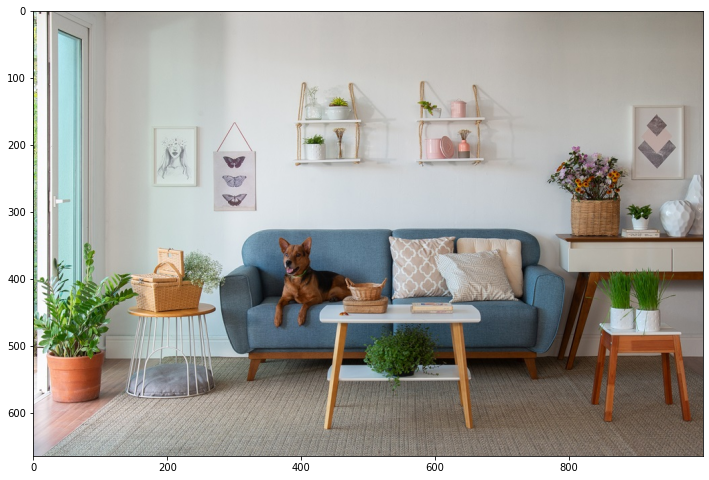

In [48]:
plt.figure(figsize=[12,12])
plt.imshow(image)
plt.show()

Agora que temos nossa imagem carregada pelo OpenCV, vamos criar nossas bounding boxes, que são retangulos destacados com algum objeto de possível importância na imagem, para isso, usaremos a função SelectiveSearch também da biblioteca OpenCV.

In [49]:
# usaremos o método 'fast' do selective search, mas ao final, criaremos uma função onde podemos escolher também o método 'Quality".

ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
ss.setBaseImage(image)
ss.switchToSelectiveSearchFast()
retangulos = ss.process()

In [50]:
# vendo a quantidade de retangulos criadas com o processo.

retangulos.shape

(4632, 4)

Vamos então ver alguns desses retangulos? 

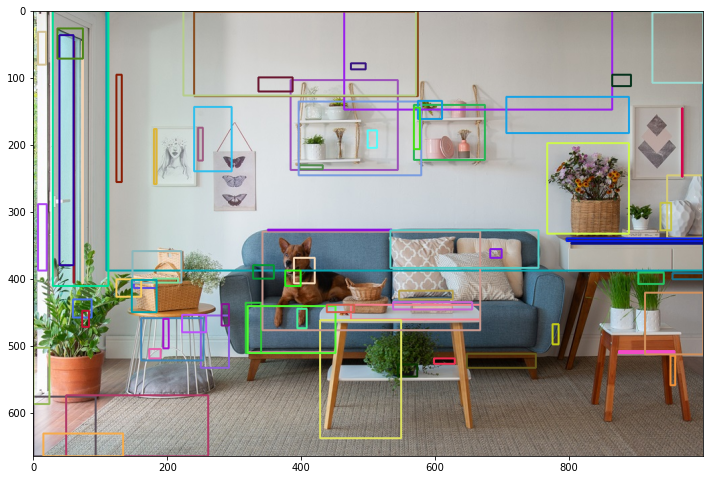

In [51]:
k = 75

retangulos_aleatorios = retangulos[np.random.randint(low = 0, high = retangulos.shape[0], size = k),]
output = image.copy()

plt.figure(figsize= [12,12])
for (a, b, w, h) in retangulos[0:k,]:
		color = [np.random.randint(0, 255) for j in range(0, 3)]
		cv2.rectangle(output, (a, b), (a + w, b + h), color, 2)

plt.imshow(output)
plt.show()

Conseguimos ver esses 75 retangulos alguns objetos já em destaque, nosso próximo passo é salvar alguns desses retangulos em uma nova matriz, para assim trabalhar com eles.

### Separando os retangulos

Cada retângulo gerado pelo selective search tem altura e comprimento diferentes, se apenas recortarmos a imagem de acordo com eles, não poderemos aplicar diretamente na VGG19, pois a VGG 19 aceita imagens com formato de 224x224 pixels.

Precisamos então fazer um redimensionamento nas imagens novas, vamos fazer isso com o primeiro retângulo no código abaixo:

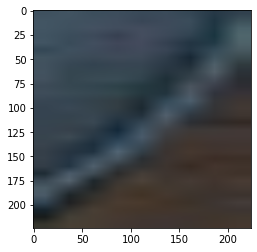

In [52]:
# redimensionando e plotando a imagem gerada com o primeiro retângulo do selective search.

x,y,w,h = retangulos[0]

image1 = image[y:y+h, x:x+w]

image1 = cv2.resize(image1, dsize=(224, 224))

plt.imshow(image1)

In [53]:
# conferindo a dimensão da imagem

image1.shape

(224, 224, 3)

O próximo passo é juntar todas alguns dessas imagens em um array novo, onde cada linha desse array, é uma imagem colorida de 224x224 pixels, em termos de matrizes, cada linha desse array vai ser um elemento de tamanho (224,224,3).

Vamos escolher os retangulos onde a base ou a altura não passe de 10% do tamanho total da imagem, assim, conseguiremos reduzir muitos triângulos que pegam grande parte da imagem, afinal, os objetos de uma imagem quase nunca vão ocupar um grande espaço nela.

In [54]:
retangulos_imagem = image1.reshape(1,224,224,3)

for i in range(1,retangulos.shape[0]):
  H, W = image.shape[:2]
  x,y,w,h = retangulos[i]
  if w/float(W) < 0.1 or h/float(H) < 0.1: 
    continue
  imagem2 = image[y:y+h, x:x+w]
  imagem2 = cv2.resize(imagem2, dsize=(224, 224))
  imagem2 = imagem2.reshape(1,224,224,3)
  retangulos_imagem = np.concatenate((retangulos_imagem, imagem2))



Vamos conferir o tamanho do nosso novo array.

In [55]:
 retangulos_imagem.shape

(1243, 224, 224, 3)

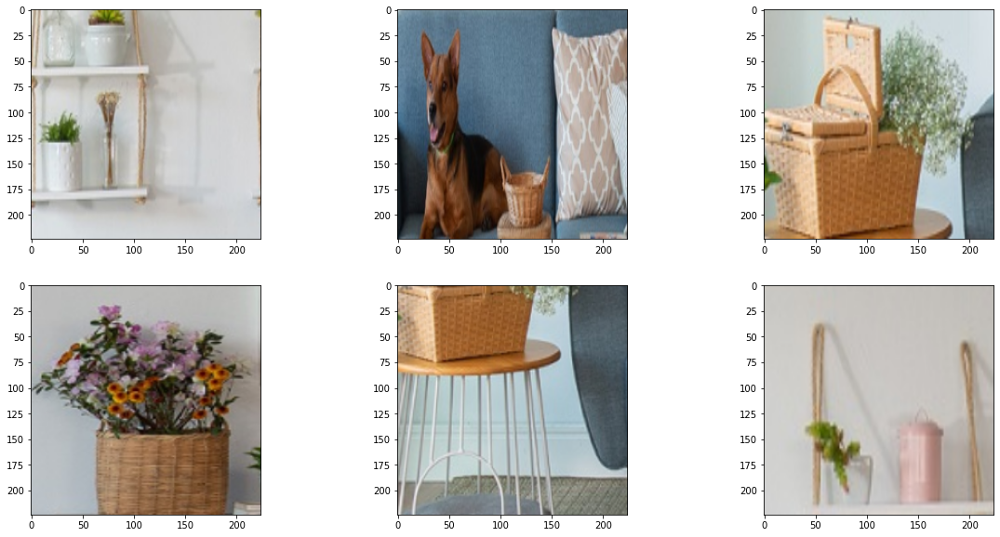

In [66]:
# conferindo algumas imagens do nosso array:

plt.figure(figsize = [20,10])

plt.subplot(2,3,1)
plt.imshow(retangulos_imagem[5])

plt.subplot(2,3,2)
plt.imshow(retangulos_imagem[100])

plt.subplot(2,3,3)
plt.imshow(retangulos_imagem[200])

plt.subplot(2,3,4)
plt.imshow(retangulos_imagem[300])

plt.subplot(2,3,5)
plt.imshow(retangulos_imagem[400])

plt.subplot(2,3,6)
plt.imshow(retangulos_imagem[720])

plt.show()

Agora que estamos com as imagens geradas pelo selective search redimensionadas e todas organizadas em um novo array, vamos importar o VGG19 para fazer nossa aplicação.

In [67]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow import keras
from keras.applications.vgg19 import preprocess_input
from keras.applications.vgg19 import decode_predictions
from keras.applications.vgg19 import VGG19

Antes de implementar as imagens na VGG19, precisamos fazer um pré-processamento nelas, faremos isso em todas as imagens do array criado acima, e criaremos um novo array, que no caso, as imagens já estarão redimensionadas, pré-processadas e organizadas em um único lugar.

Faremos isso no código abaixo.

In [68]:
retangulos_imagem1 = retangulos_imagem[0].reshape(1,224,224,3)

retangulos_imagem1 = preprocess_input(retangulos_imagem1)

for i in range(1,retangulos_imagem.shape[0]):
  imagem2 = retangulos_imagem[i].reshape((1,224,224,3))
  imagem2 = preprocess_input(imagem2)
  retangulos_imagem1 = np.concatenate((retangulos_imagem1, imagem2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


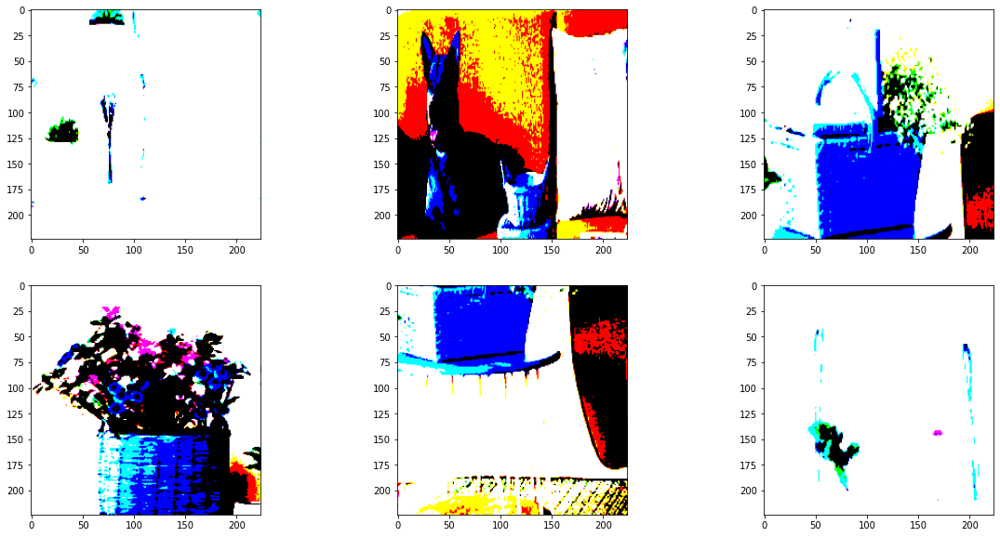

In [70]:
# conferindo algumas imagens do nosso novo array:

plt.figure(figsize = [20,10])

plt.subplot(2,3,1)
plt.imshow(retangulos_imagem1[5])

plt.subplot(2,3,2)
plt.imshow(retangulos_imagem1[100])

plt.subplot(2,3,3)
plt.imshow(retangulos_imagem1[200])

plt.subplot(2,3,4)
plt.imshow(retangulos_imagem1[300])

plt.subplot(2,3,5)
plt.imshow(retangulos_imagem1[400])

plt.subplot(2,3,6)
plt.imshow(retangulos_imagem1[720])

plt.show()

In [71]:
# conferindo mais uma vez o tamanho

retangulos_imagem1.shape

(1243, 224, 224, 3)

### Fazendo as predições

Agora que fizemos todo o tratamento necessário para usar a VGG19, vamos fazer as predições em cada um das imagens geradas pelo selective search.

In [72]:
modelo = VGG19()

In [73]:
# fazendo as predições e tomando a predição com maior probabilidade em cada uma das imagens.

ypred = modelo.predict(retangulos_imagem1)
ypredd = decode_predictions(ypred, top = 1)

Lembrando que temos masi de mil imagens, cada uma teve uma previsão feita pelo VGG19, vamos então fazer um filtro, vamos pegar aquelas imagens no qual tiveram uma previsão maior do que ou igual a 70% de ser algum objeto e colocaremos tudo em um dicionário, onde a chave é o retângulo e o valor é o objeto e a sua probabilidade.

In [74]:
labels = {}

for i in range(len(ypredd)):
  if ypredd[i][0][2]>=0.7:
    labels[ypredd.index(ypredd[i])] = ypredd[i]

In [75]:
labels

{1: [('n03961711', 'plate_rack', 0.92517126)],
 2: [('n03961711', 'plate_rack', 0.78489447)],
 11: [('n03482405', 'hamper', 0.810285)],
 20: [('n03991062', 'pot', 0.8536429)],
 28: [('n03482405', 'hamper', 0.7832561)],
 51: [('n02110806', 'basenji', 0.76398814)],
 56: [('n03991062', 'pot', 0.98564523)],
 57: [('n03961711', 'plate_rack', 0.8698394)],
 65: [('n03938244', 'pillow', 0.79481643)],
 68: [('n03938244', 'pillow', 0.9312344)],
 80: [('n03961711', 'plate_rack', 0.7885267)],
 94: [('n03991062', 'pot', 0.9420974)],
 123: [('n03938244', 'pillow', 0.84310466)],
 128: [('n03991062', 'pot', 0.8489061)],
 136: [('n03938244', 'pillow', 0.89510137)],
 140: [('n02110806', 'basenji', 0.9346287)],
 143: [('n03961711', 'plate_rack', 0.84518677)],
 161: [('n03482405', 'hamper', 0.83354807)],
 162: [('n03961711', 'plate_rack', 0.75240594)],
 164: [('n03938244', 'pillow', 0.738843)],
 173: [('n03961711', 'plate_rack', 0.7630754)],
 194: [('n03938244', 'pillow', 0.9492948)],
 201: [('n03991062',

Vamos então plotar as imagens e suas probabildades.

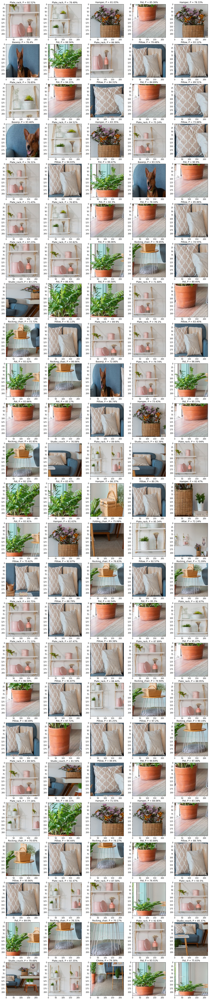

In [112]:
plt.figure(figsize=[20,100])

for n in range(len(labels)):
  x = retangulos_imagem[list(labels.keys())[n]] 
  plt.subplot(25,5,n+1)
  plt.title(labels[list(labels.keys())[n]][0][1].capitalize() + ", P = " 
              + str(round((labels[list(labels.keys())[n]][0][2])*100,2))+'%')
  plt.imshow(x)
plt.show()

Tivemos uma quantidade muito boa de acertos, o algoritmo conseguiu detectar praticamente todos os itens da sala, incluindo o cachorro e sua raça

Para juntar tudo que fizemos, criaremos uma função, que vai receber a imagem, a qualidade do selective seach e o limiar de probabildade que desejamos ter, e a função irá plotar todas as imagens com sua respectiva predição e porcentagem de probabilidade.

In [118]:
def detectaObjeto(imagem, qualidade, limiar = 0.7):
  image = cv2.imread(imagem)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
  ss.setBaseImage(image)
  if qualidade == 'fast':
    ss.switchToSelectiveSearchFast()
  else:
    ss.switchToSelectiveSearchQuality()

  retangulos = ss.process()
  x,y,w,h = retangulos[0]
  image1 = image[y:y+h, x:x+w]
  image1 = cv2.resize(image1, dsize=(224, 224))
  retangulos_imagem = image1.reshape(1,224,224,3)

  for i in range(1,retangulos.shape[0]):
    H, W = image.shape[:2]
    x,y,w,h = retangulos[i]
    if w/float(W) < 0.1 or h/float(H) < 0.1: 
     continue
    imagem2 = image[y:y+h, x:x+w]
    imagem2 = cv2.resize(imagem2, dsize=(224, 224))
    imagem2 = imagem2.reshape(1,224,224,3)
    retangulos_imagem = np.concatenate((retangulos_imagem, imagem2))

  retangulos_imagem1 = retangulos_imagem[0].reshape(1,224,224,3)
  retangulos_imagem1 = preprocess_input(retangulos_imagem1)

  for i in range(1,retangulos_imagem.shape[0]):
    imagem2 = retangulos_imagem[i].reshape((1,224,224,3))
    imagem2 = preprocess_input(imagem2)
    retangulos_imagem1 = np.concatenate((retangulos_imagem1, imagem2))
  
  modelo = VGG19()
  ypred = modelo.predict(retangulos_imagem1)
  ypredd = decode_predictions(ypred, top = 1)

  labels = {}

  for i in range(len(ypredd)):
    if ypredd[i][0][2]>=limiar:
      labels[ypredd.index(ypredd[i])] = ypredd[i]
  
  plt.figure(figsize=[20,int(len(labels)*0.8)+1])

  for n in range(len(labels)):
    x = retangulos_imagem[list(labels.keys())[n]] 
    plt.subplot(int(len(labels)/5) + 1,5,n+1)
    plt.title(labels[list(labels.keys())[n]][0][1].capitalize() + ", P = " 
              + str(round((labels[list(labels.keys())[n]][0][2])*100,2))+'%')
    plt.imshow(x)
  plt.show()
  
  

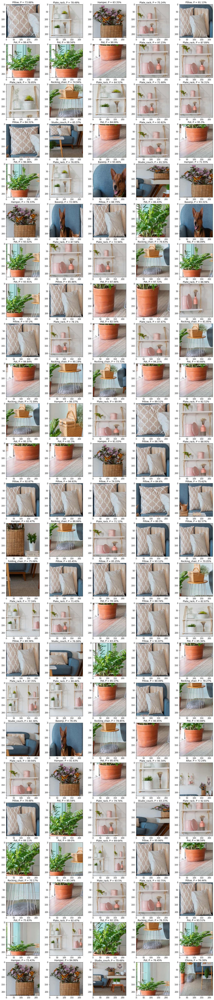

In [119]:
detectaObjeto('sala.jpg', 'fast')

Conseguimos então juntar tudo em uma única função, para finalizar, pegaremos mais uma imagem, dessa vez, de uma cozinha

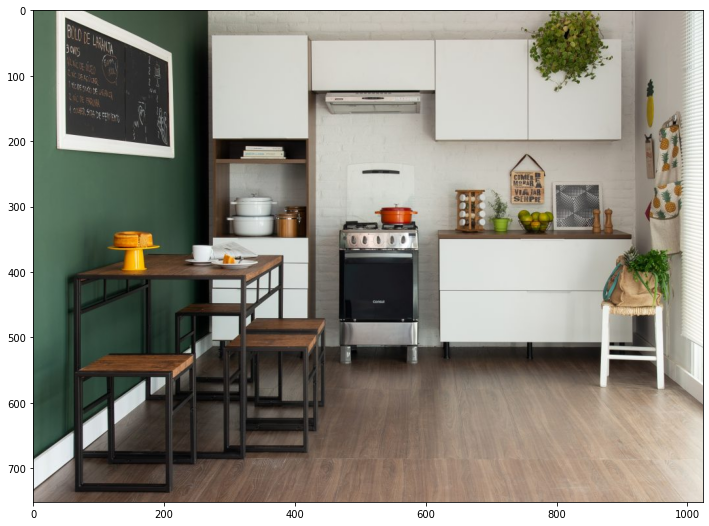

In [120]:
cozinha = cv2.imread('cozinha.jpg')
cozinha = cv2.cvtColor(cozinha, cv2.COLOR_BGR2RGB)
plt.figure(figsize=[12,12])
plt.imshow(cozinha)
plt.show()

Vamos ver como nosso algoritmo se sai com essa imagem:

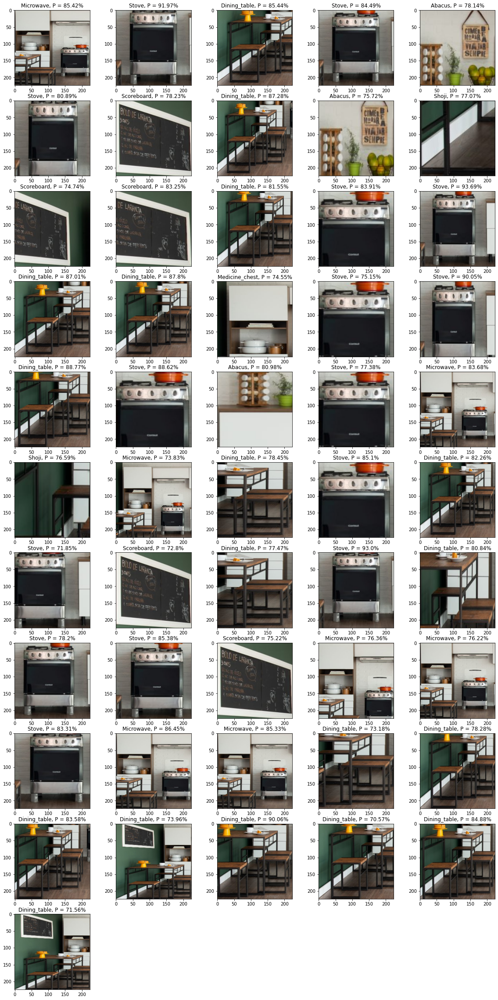

In [121]:
detectaObjeto('cozinha.jpg','fast')

Conseguimos também um ótimo resultado, a função detectou vários dos objetos da imagem.

Finalizamos aqui o notebook.